# Forest Cover Type Prediction
[Instructions (Kaggle)](https://www.kaggle.com/uciml/forest-cover-type-dataset)

_"Use cartographic variables to classify forest categories"_

1. Data exploration
2. Feature selection
3. Model evaluation
4. Conclusions

Goal: Maximize average accuracy

### Information from Instructions

* Elevation - Elevation in meters הגבהה
* Aspect - Aspect in degrees azimuth
* Slope - Slope in degrees (0-360) מדרון
* Horizontal_Distance_To_Hydrology - Horz Dist to nearest surface water features
* Vertical_Distance_To_Hydrology - Vert Dist to nearest surface water features
* Horizontal_Distance_To_Roadways - Horz Dist to nearest roadway
* Hillshade_9am (0 to 255 index) - Hillshade index at 9am, summer solstice
* Hillshade_Noon (0 to 255 index) - Hillshade index at noon, summer solstice
* Hillshade_3pm (0 to 255 index) - Hillshade index at 3pm, summer solstice
* Horizontal_Distance_To_Fire_Points - Horz Dist to nearest wildfire ignition points
* Wilderness_Area (4 binary columns, 0 = absence or 1 = presence) - Wilderness area designation
* Soil_Type (40 binary columns, 0 = absence or 1 = presence) - Soil Type designation
* Cover_Type (7 types, integers 1 to 7) - Forest Cover Type designation

### Download

In [12]:
# Dowloading the data from Kaggle (run once- only if covtype.csv not in folder)
!kaggle datasets download uciml/forest-cover-type-dataset
!unzip forest-cover-type-dataset.zip
!ls

  0%|                                               | 0.00/11.2M [00:00<?, ?B/s]
100%|███████████████████████████████████████| 11.2M/11.2M [00:00<00:00, 205MB/s]


## Imports

In [1]:
# Processing
import numpy as np
import pandas as pd
from scipy.spatial import distance_matrix
from scipy.spatial.distance import cdist
import math
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split, KFold, StratifiedKFold
 
from imblearn.under_sampling import RandomUnderSampler, NearMiss
    
# Visualizations
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt

# Models related
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import (accuracy_score, confusion_matrix, classification_report)

from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

# Other
from tqdm import tqdm


## Constants

In [2]:
# Paths n' stuff
INPUT_DATA_PATH = "covtype.csv"

# Names
NUMERIC_COLS = ['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology',
                'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways',
                'Hillshade_9am', 'Hillshade_Noon', 'Hillshade_3pm',
                'Horizontal_Distance_To_Fire_Points']
BINARIC_COLS = ['Wilderness_Area{}'.format(i) for i in range(1, 5)] + ['Soil_Type{}'.format(i) for i in range(1, 41)]
TARGET_COL = 'Cover_Type'

# Default sizes
N_FOLDS = 10
TEST_SET_SIZE = 0.5
STD_FOR_OUTLIER = 3
MIN_NEIGHBORS_NUM = 1
MAX_NEIGHBORS_NUM = 21
RANDOM_SEED = 6
SCALING_RANGE = (0,1)

## Code

### Functions

In [3]:
# Returns indices of possible outliers that are more than from STD_FOR_OUTLIER stds away from
# mean - assuming they are outliers
def find_outliers(ser, how_many_std=STD_FOR_OUTLIER):
    ans=[]
    mask = (abs(ser-ser.mean())>how_many_std*ser.std())
    ans.extend(ser.loc[mask].index)
    return ans

# Calculating distance matrix for precomuted Knn
def calculate_distance_matrix(df):
    df_for_np = np.array(df)
    return np.sqrt(np.sum(df_for_np ** 2, axis=1)
                   -2* np.dot(df_for_np, df_for_np.T)
                   + np.reshape(np.sum(df_for_np ** 2, axis=1), (-1,1)))

# Calculate averagae accuracy
def average_accuracy(y_real, y_pred, get_per_class=False):
    conf_matrix = confusion_matrix(y_real, y_pred)
    acc_per_class = np.diagonal(conf_matrix)/np.sum(conf_matrix, axis=1)
    return acc_per_class if get_per_class else np.average(acc_per_class)

### Data Reading

In [106]:
full_df = pd.read_csv(INPUT_DATA_PATH)

full_df.head()

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points,...,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40,Cover_Type
0,2596,51,3,258,0,510,221,232,148,6279,...,0,0,0,0,0,0,0,0,0,5
1,2590,56,2,212,-6,390,220,235,151,6225,...,0,0,0,0,0,0,0,0,0,5
2,2804,139,9,268,65,3180,234,238,135,6121,...,0,0,0,0,0,0,0,0,0,2
3,2785,155,18,242,118,3090,238,238,122,6211,...,0,0,0,0,0,0,0,0,0,2
4,2595,45,2,153,-1,391,220,234,150,6172,...,0,0,0,0,0,0,0,0,0,5


In [107]:
# Train test split
train_df, test_df = train_test_split(full_df, test_size=TEST_SET_SIZE, random_state=RANDOM_SEED)
print("Train shape: {}".format(train_df.shape))
print("Test shape: {}".format(test_df.shape))

Train shape: (290506, 55)
Test shape: (290506, 55)


In [7]:
train_df.describe()

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points,...,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40,Cover_Type
count,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,...,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000
mean,2959.526247,155.650995,14.094497,269.415141,46.328737,2347.498964,212.138672,223.336072,142.563999,1979.908845,...,0.090628,0.078363,0.002795,0.003294,0.000207,0.000506,0.027108,0.023741,0.014829,2.051486
std,279.832605,111.951722,7.483559,212.614119,58.112616,1557.310945,26.721505,19.761381,38.268488,1322.472426,...,0.287080,0.268743,0.052795,0.057301,0.014370,0.022489,0.162398,0.152242,0.120870,1.397683
min,1863.000000,0.000000,0.000000,0.000000,-173.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,2809.000000,58.000000,9.000000,108.000000,7.000000,1104.000000,198.000000,213.000000,119.000000,1025.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
50%,2996.000000,127.000000,13.000000,218.000000,30.000000,1996.000000,218.000000,226.000000,143.000000,1710.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
75%,3163.000000,261.000000,18.000000,384.000000,69.000000,3319.000000,231.000000,237.000000,168.000000,2550.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
max,3857.000000,360.000000,64.000000,1390.000000,598.000000,7117.000000,254.000000,254.000000,254.000000,7173.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,7.000000


#### Conclusions
1. Looking at the numeric features, they have differenct ranges (some are 0 to 255 while others are much larger)
2. Possible feature: Distance_To_Hydrology usinf vertical and horizontal distance
3. Possible features: Extremely stone/stony/rubbly (using the information given)

### Visualizations

In [12]:
# Histograms - dist
fig = make_subplots(rows=2, cols=5,
                    subplot_titles=(NUMERIC_COLS))
curr_row = 1
curr_col = 1
for col in NUMERIC_COLS:
    # Create figure
    fig.add_trace(go.Histogram(x=train_df[col], name="{} Count".format(col)), 
                  col=curr_col, 
                  row=curr_row)
    fig.update_xaxes(title_text="Value", row=curr_row, col=curr_col)

    # Update row & colunm
    curr_row = curr_row if curr_col!=5 else curr_row+1
    curr_col = (curr_col)%5+1
    
fig.update_layout(height=750, width=1500, title_text="Histograms of Numeric Features")
fig.update_yaxes(title_text="Count", row=1, col=1)
fig.update_yaxes(title_text="Count", row=2, col=1)
fig.show()

In [13]:
# Bar plots - binary values
fig = make_subplots(rows=2, cols=1,
                    subplot_titles=("Wilderness Areas", "Soil Types"))
fig.add_trace(go.Bar(x=BINARIC_COLS[:4], 
                     y=train_df[BINARIC_COLS[:4]].sum(), 
                     name="Wilderness Area"), col=1, row=1)
fig.add_trace(go.Bar(x=BINARIC_COLS[4:], 
                     y=train_df[BINARIC_COLS[4:]].sum(), 
                     name="Soil Type"), col=1, row=2)

fig.update_layout(title_text="Histograms of Binary Features")
fig.update_yaxes(title_text="Count", row=1, col=1)
fig.update_yaxes(title_text="Count", row=2, col=1)

fig.show()

In [53]:
# Histogram - Target Value
fig = px.histogram(train_df, x=TARGET_COL)
fig.update_layout(height=300, width=500, title_text=TARGET_COL)
fig.show()

#### Conclusions
1. Hillshade_3pm looks normally distributed
2. Most of the numeric feature are right/left skewed
3. The cover type is very unbalanced - need to check resampling
4. Some soil types are not available in the training data (7,15), some are very rare (8,9,21,25,27,28,36,37) and others are common
5. Wilderness_Area 2 and 4 are not as common as the others

In [16]:
# Seeing the amount of each cover type in each binary feature
cover_per_soil_df = train_df[BINARIC_COLS+[TARGET_COL]].groupby(TARGET_COL).sum()

fig = go.Figure(data=[go.Bar(name="Cover Type {}".format(row), 
                             x=cover_per_soil_df.columns[:4], 
                             y=cover_per_soil_df.loc[row]) for row in cover_per_soil_df.index])
fig.update_layout(title_text="Wilderness Area per Cover Type")
fig.update_yaxes(title_text="Count")
fig.show()

fig = go.Figure(data=[go.Bar(name="Cover Type {}".format(row), 
                             x=cover_per_soil_df.columns[4:], 
                             y=cover_per_soil_df.loc[row]) for row in cover_per_soil_df.index])
fig.update_layout(title_text="Soil Type per Cover Type", width=1000)
fig.update_yaxes(title_text="Count")
fig.show()

#### Conclusions
1. There are many binary feature that have no examples of some cover types

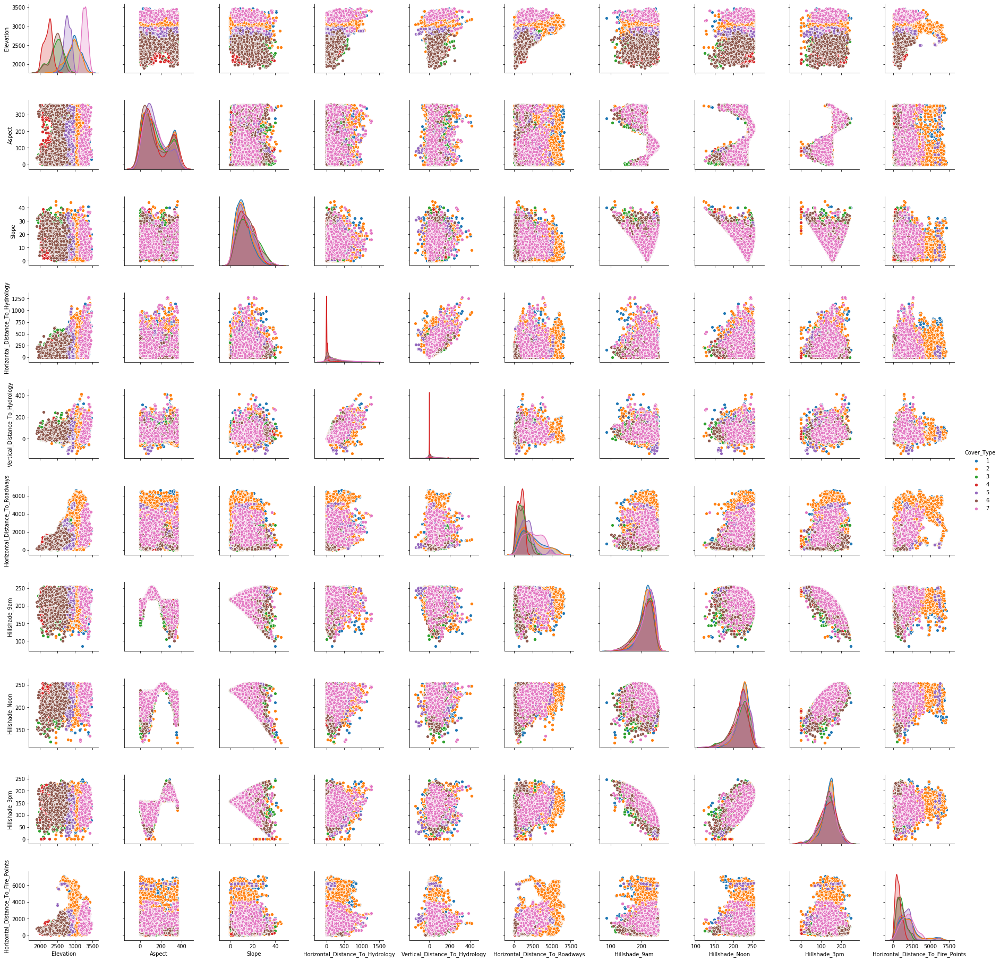

In [89]:
# Scatter matrix (numeric values), with attention to the target value
sns.pairplot(train_df[NUMERIC_COLS+[TARGET_COL]], hue=TARGET_COL)


The output for the pairplor (if too lazy to re-run the 6 minutes cell above)
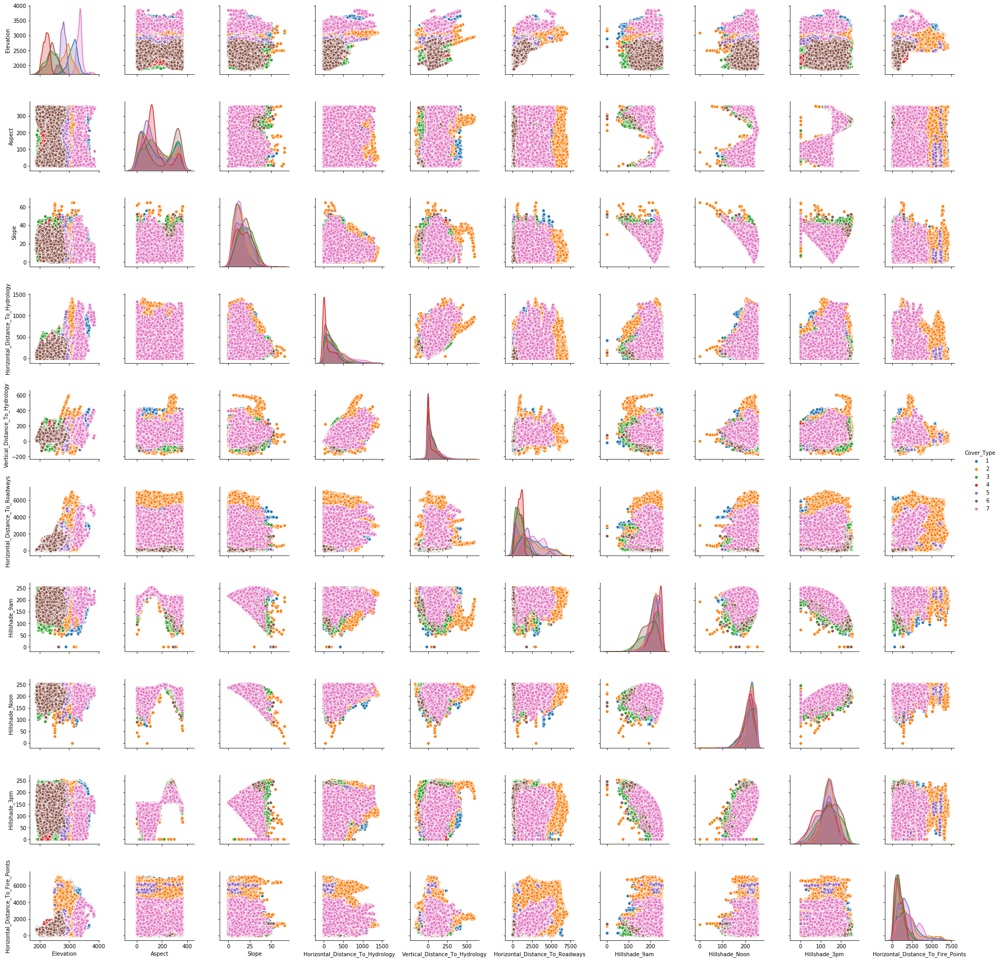

#### Conclusions
1. Elevation,Horizontal_Distance_To_Hydrology looks pretty distinctive with respect to Cover_Type
2. There are super cool relationhsips between {Aspect, Slope, Hillshade_X} and {Hillshade_X}
3. Maybe try and use polaric representation at Hillshade_3pm&Aspect

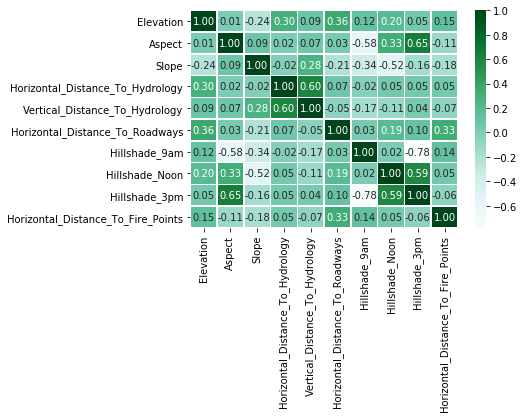

In [17]:
# Correlations among the numberic features for possible dimension reduction
sns.heatmap(train_df[NUMERIC_COLS].corr(), 
            annot=True, 
            fmt=".2f", 
            linewidths=.5, 
            cmap="BuGn")

#### Conclusions
1. Aspect & Hillshade_9am = -0.58
2. Aspect & Hillshade_3pm = 0.65
2. Slope & Hillshade_Noon = -0.53
3. Horizontal_Distance_To_Hydrology & Vertical_Distance_To_Hydrology = 0.61
4. Hillshade_9am & Hillshade_3pm = -0.78
5. Hillshade_Noon & Hillshade_3pm = 0.59
6. There is no reason to examine correlation with target columns because it's categorical 

### Missing & Fishy Values

In [6]:
assert not train_df.isna().any().any(), "Found a na value in the dataframe"

not_one_wilderness = train_df.loc[train_df[BINARIC_COLS[:4]].transpose().sum()!=1]
assert len(not_one_wilderness) == 0, "Some samples have 0/more than 1 Wilderness_Area"

not_one_soil = train_df.loc[train_df[BINARIC_COLS[4:]].transpose().sum()!=1]
assert len(not_one_soil) == 0, "Some samples have 0/more than 1 Soil_Type"


### Data Processing

#### Outliers Examination

In [8]:
col_outliers = {}
for col_name in set(NUMERIC_COLS).intersection(set(train_df.columns)):
    possible_outliers = find_outliers(train_df[col_name])
    col_outliers[col_name] = possible_outliers
# NOTE: I left this direction because KNN outperformed GNB and LDA and I think outliers have a small impact on this model
# (all samples will be far from the outlier->it won't affect any classification)

#### Adding & dropping features

In [108]:
new_numeric_features = NUMERIC_COLS

In [109]:
# This feature addition raises a SettingWithCopy warning but the output is fine
train_df.loc[:,'distance_To_Hydrology'] = np.sqrt(train_df['Horizontal_Distance_To_Hydrology'] ** 2
                                           + train_df['Vertical_Distance_To_Hydrology'] ** 2)

new_numeric_features = new_numeric_features+['distance_To_Hydrology']

# Dropping features that are correlated with others
train_df = train_df.drop(['Aspect', 'Hillshade_Noon', 'Hillshade_9am'], axis=1)

new_numeric_features = list(set(new_numeric_features).intersection(set(train_df.columns)))
temp_new_numeric_features = new_numeric_features
extra_numeric_features = []

for f1 in temp_new_numeric_features:
    for f2 in temp_new_numeric_features:
        if f1!=f2 and '{}_plus_{}'.format(f2,f1) not in train_df.columns:
            train_df.loc[:,'{}_plus_{}'.format(f1,f2)] = train_df[f1]+train_df[f2]
            train_df.loc[:,'{}_sub_{}'.format(f1,f2)] = train_df[f1]-train_df[f2]            
            train_df.loc[:,'{}_mul_{}'.format(f1,f2)] = train_df[f1]*train_df[f2]
            extra_numeric_features = extra_numeric_features+['{}_plus_{}'.format(f1,f2),
                                                             '{}_sub_{}'.format(f1,f2), 
                                                             '{}_mul_{}'.format(f1,f2)]

/home/dev/installs/anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:844: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
/home/dev/installs/anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:965: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s


#### Manipulations

In [34]:
# Scaling the numeric data using a 0/1 normalization - normalized data
scaler = MinMaxScaler(feature_range=SCALING_RANGE)
scaler.fit(train_df.drop(TARGET_COL, axis=1))
normalized_train_df = pd.DataFrame(data=scaler.transform(train_df.drop(TARGET_COL, axis=1)),
                                  columns=train_df.drop(TARGET_COL, axis=1).columns, index=train_df.index)
normalized_train_df = pd.concat([normalized_train_df, 
                                 train_df[TARGET_COL]], axis=1)

normalized_train_df.describe()

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points,...,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40,Cover_Type
count,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,...,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000,290506.000000
mean,0.549913,0.432364,0.220227,0.193824,0.284473,0.329844,0.835192,0.879276,0.561276,0.276022,...,0.090628,0.078363,0.002795,0.003294,0.000207,0.000506,0.027108,0.023741,0.014829,2.051486
std,0.140337,0.310977,0.116931,0.152960,0.075373,0.218816,0.105203,0.077801,0.150663,0.184368,...,0.287080,0.268743,0.052795,0.057301,0.014370,0.022489,0.162398,0.152242,0.120870,1.397683
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,0.474423,0.161111,0.140625,0.077698,0.233463,0.155122,0.779528,0.838583,0.468504,0.142897,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
50%,0.568205,0.352778,0.203125,0.156835,0.263294,0.280455,0.858268,0.889764,0.562992,0.238394,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
75%,0.651956,0.725000,0.281250,0.276259,0.313878,0.466348,0.909449,0.933071,0.661417,0.355500,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,7.000000


### Model Evaluation


In [45]:
# normalized_train_df
# train_df
# normalized_train_resampled_df

# [NUMERIC_COLS+[TARGET_COL]]
# [new_numeric_features + [TARGET_COL]]
# [extra_numeric_features + [TARGET_COL]]

chosen_df = train_df[NUMERIC_COLS + [TARGET_COL]]

#### Regular Evaluation

In [89]:
# Take 1: use all features with default models
# Take 2: use all normalized features
# This cell takes about 20 minutes
knn_models = [("KNN-{}".format(neighbors_num),
               KNeighborsClassifier(n_neighbors=neighbors_num))
              for neighbors_num in range(MIN_NEIGHBORS_NUM, MAX_NEIGHBORS_NUM)]

X, y = chosen_df.drop([TARGET_COL], axis=1), chosen_df[TARGET_COL]

accuracy_dict = {}

for name, model in tqdm(knn_models):
    y_preds = cross_val_predict(model, X, y, cv=N_FOLDS)
    accuracy_dict[model.n_neighbors] = average_accuracy(y, y_preds)
        
fig = go.Figure(data=go.Scatter(x=list(accuracy_dict.keys()), y=list(accuracy_dict.values())))
fig.update_layout(title_text="Average Accuracy per Number of Neighbors")
fig.update_yaxes(title_text="Average Accuracy")
fig.update_xaxes(title_text="Neighbor number")
fig.show()        


100%|██████████| 20/20 [25:44<00:00, 77.23s/it]


Text(0.5, 69.0, 'Predicted Values')

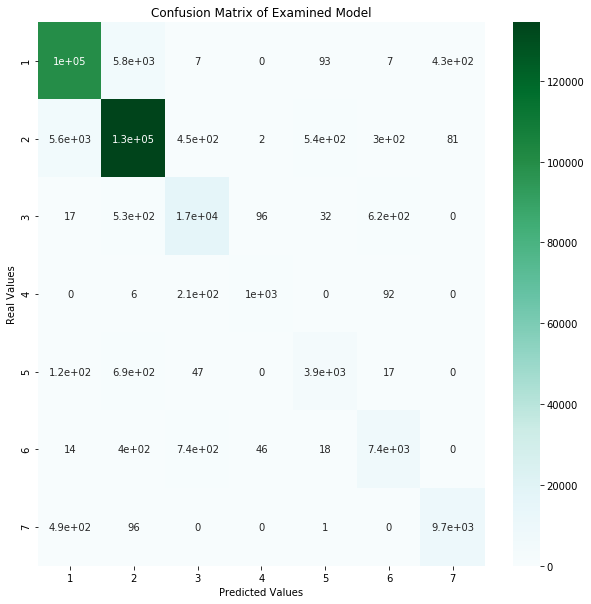

In [71]:
X, y = chosen_df.drop([TARGET_COL], axis=1), chosen_df[TARGET_COL]

y_preds = cross_val_predict(KNeighborsClassifier(n_neighbors=3), X, y, cv=N_FOLDS)
conf_matrix_df = pd.DataFrame(data=confusion_matrix(y, y_preds), index = range(1,8), columns=range(1,8))
fig,ax = plt.subplots(figsize=(10,10))
sns.heatmap(conf_matrix_df, annot=True, ax=ax, cmap="BuGn")
ax.set_title(f'Confusion Matrix of Examined Model')
ax.set_ylabel('Real Values')
ax.set_xlabel('Predicted Values')

In [72]:
# =these are the results of the full df
print(average_accuracy(y, y_preds, get_per_class=True))

[0.94031568 0.95086278 0.92808601 0.76574501 0.81831456 0.8586679
 0.94273811]


In [44]:
# Still take 1/2: trying non-knn models
non_knn_models = [("LDA", LinearDiscriminantAnalysis()), 
                  ("GNB", GaussianNB())]

X, y = chosen_df.drop([TARGET_COL], axis=1), chosen_df[TARGET_COL]

accuracy_dict = {}

for name, model in tqdm(non_knn_models):
    y_preds = cross_val_predict(model, X, y, cv=N_FOLDS)
    accuracy_dict[name] = average_accuracy(y, y_preds)
accuracy_dict

100%|██████████| 2/2 [00:05<00:00,  2.79s/it]


{'LDA': 0.3731933112657004, 'GNB': 0.4603280841763874}

#### Resampled Evaluation
In order to build a special validation method (so we don't use the resampled validation) 

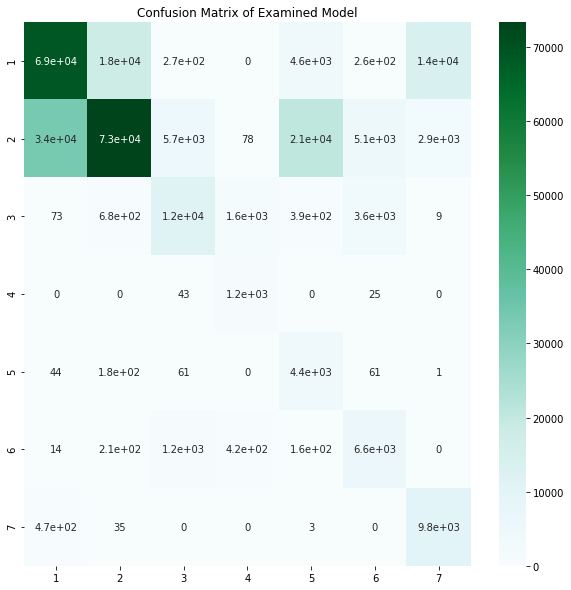

In [34]:
skf=StratifiedKFold(n_splits=N_FOLDS)
rus = RandomUnderSampler(random_state=RANDOM_SEED+3)
    
model = KNeighborsClassifier(n_neighbors=3)

X, y = chosen_df.drop([TARGET_COL], axis=1), chosen_df[TARGET_COL]
y_real = []
y_preds = []

for train_index, val_index in skf.split(X, y):
    X_train, X_val = X.iloc[train_index], X.iloc[val_index]
    y_train, y_val = y.iloc[train_index], y.iloc[val_index]
    
    # resample train set
    X_train, y_train = rus.fit_resample(X_train, y_train)
    
    # fit the model
    model.fit(X_train, y_train)
    
    
    # predict & get accuracy
    y_real = y_real+list(y_val)
    y_preds = y_preds+list(model.predict(X_val))
    
conf_matrix_df = pd.DataFrame(data=confusion_matrix(y_real, y_preds), index = range(1,8), columns=range(1,8))
fig,ax = plt.subplots(figsize=(10,10))
sns.heatmap(conf_matrix_df, annot=True, ax=ax, cmap="BuGn")
ax.set_title(f'Confusion Matrix of Examined Model')
ax.set_ylabel('Real Values')
ax.set_xlabel('Predicted Values')

In [35]:
# - results for the resampled df
print(average_accuracy(y, y_preds, get_per_class=True))

[0.61708688 0.49641244 0.58071524 0.8187404  0.8345849  0.68403342
 0.85476214]


#### Accuracy per Class (Only Numeric Features)
##### RUS (regular df)
0.60572517 0.49694969 0.64349376 0.82949309 0.8521068  0.71675563 0.86590447
##### (regular df)
0.89273794 0.91247764 0.854668   0.67050691 0.76136838 0.80970063 0.85679682
##### (Normalized df)
0.84485847 0.8737744  0.77796346 0.56374808 0.62265332 0.66964493 0.79972871
##### RUS (Normalized df)
0.59177997 0.4668778  0.57074421 0.78033794 0.79495202 0.63193316 0.8436198
##### More Features (Normalized df)
0.87322031 0.89571684 0.8125557  0.65898618 0.7077597  0.75168252 0.8313148
##### RUS More Features (Normalized df)
0.60962869 0.50013785 0.57759581 0.81336406 0.8310388  0.67428638 0.85902529
##### NM More Features (Normalized df)
0.08839503 0.03291367 0.1847148  0.69354839 0.64142678 0.34033418 0.96056584

#### Conclusions
1. The model performs pretty well (accuracy for each class > 0.77), we see that the less examples the lower the scores (per class)
2. KNN outperformed GNB (0.4585) and LDA (0.6790)
3. Since the featurs are not normalized, L2 values looks more at the numeric values into consideration (since they have large values comapred to the binary ones
4. There are some (relatively) problematic pairs of classed (like 1&2 and 4s that were calssified as 3)

#### Directions
1. Normalize features (NOTE: normalized df takes alot of time because of the large data set - without normalization the algorithm probably optimizes the distance calcuation and kind of ignores the binary ones because they are relatively smaller than the numeric ones)
2. Undersample & oversample (data is very large so might be a better idea to start with undersampling)
3. Apply feature selection (after checking the normalized data and see that the results are worse, it is possible that the features wuth the bigger range of values are more indicative then the rest)
4. Add features for better distinguishing between "close classes"
5. Try a voting scheme for knn trained using resampled and regular data? Using different undersamplers yieldde similar results on each class so ensemble doesn't sound like a good idea 

#### Conclusions
1. When using normalized features with GNB - the performance dropped by alot and LDA remained the same
2. Normalized data didn't improve results for non knn (LDA - 0.58, GNB - 0.46)
3. When using only normalized numeric features, results dropped a bit but still good (3-NN - 0.91)
4. For non knn models, the settings from above still sucks (LDA - 0.37, GNB - 0.46)
5. When using only binary features, results suck
6. Adding features improves the results compared to the normalized df but not compared to the regular one
7. Resampling improves the results of classes 4,5 but damages 1,2 and somewhat 6
8. Tried giving weights to the features based on their chi score. Results were better than just normalizing but worse than regular df

## Further Examination of Missclassified Data

In [33]:
investigate_df = chosen_df.copy()
investigate_df[f'{TARGET_COL}_predicted'] = y_preds
# get all missclassified
investigate_df = investigate_df.loc[investigate_df[f'{TARGET_COL}_predicted']
                               !=investigate_df[TARGET_COL]]
investigate_df.shape

(250493, 56)

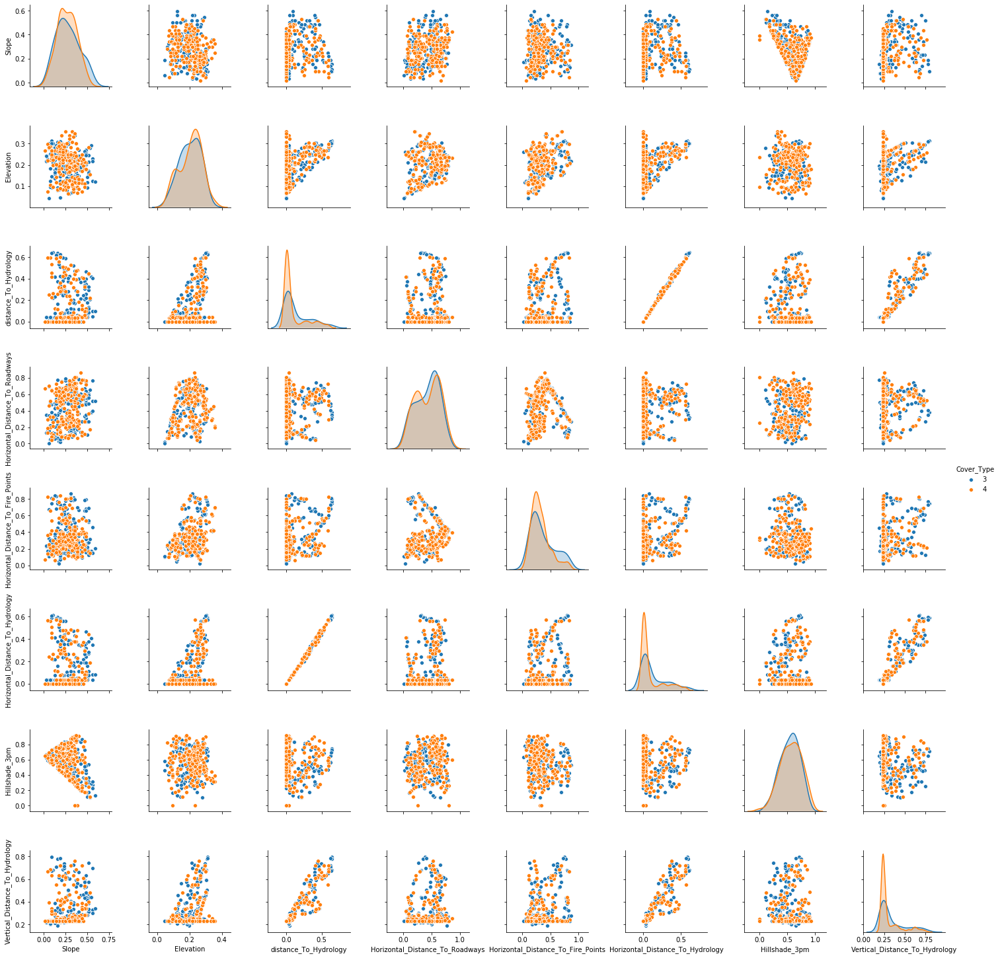

In [70]:
missclassified_pair_df = investigate_df.loc[((investigate_df[TARGET_COL]==3)
                                             & (investigate_df[f'{TARGET_COL}_predicted']==4))|
                                            ((investigate_df[TARGET_COL]==4)
                                             & (investigate_df[f'{TARGET_COL}_predicted']==3))]
# missclassified_pair_df.groupby(TARGET_COL).agg(['mean', 'std'])
sns.pairplot(missclassified_pair_df[new_numeric_features+[TARGET_COL]], hue=TARGET_COL)

In [87]:
from scipy.stats import wasserstein_distance

for col in NUMERIC_COLS:
    print(f'{col} = {wasserstein_distance(normalized_train_df[col], normalized_train_resampled_df[col])}')

Elevation = 0.1759289356717071
Aspect = 0.0780888316344762
Slope = 0.12648851154078478
Horizontal_Distance_To_Hydrology = 0.04314743476402849
Vertical_Distance_To_Hydrology = 0.12192618386142591
Horizontal_Distance_To_Roadways = 0.07168628483833878
Hillshade_9am = 0.04525810469690062
Hillshade_Noon = 0.1427139748620247
Hillshade_3pm = 0.06550315676439067
Horizontal_Distance_To_Fire_Points = 0.14271113583946293


#### Conclusions
1. Sadly, can't see any good direction (data looks fairly similar for the classes and the distance is realtively small)
2. Using different random under samplers yields similar results (performs bad at the same classes)
3. Read about "metric learning" sometime

## Test Set Handling

Text(0.5, 69.0, 'Predicted Values')

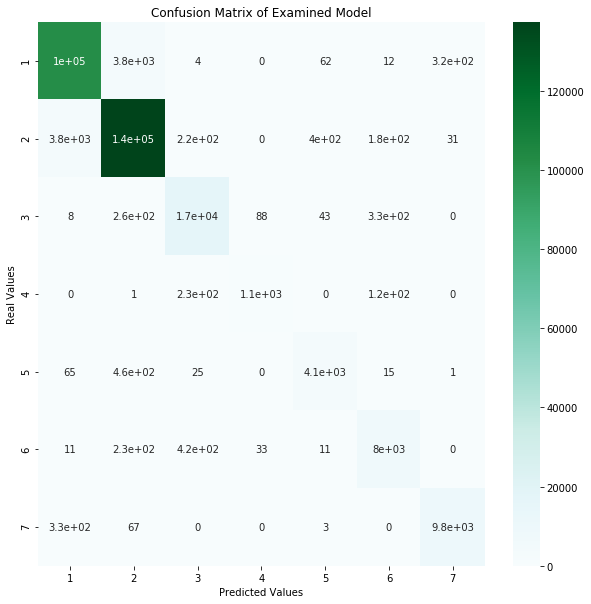

In [73]:
# Best results were given when using the numeric features of the regular df
model = KNeighborsClassifier(n_neighbors=3)
model.fit(train_df[NUMERIC_COLS], train_df[TARGET_COL])

y_preds, y_test = model.predict(test_df[NUMERIC_COLS]), test_df[TARGET_COL]

conf_matrix_df = pd.DataFrame(data=confusion_matrix(y_test, y_preds), index = range(1,8), columns=range(1,8))
fig,ax = plt.subplots(figsize=(10,10))
sns.heatmap(conf_matrix_df, annot=True, ax=ax, cmap="BuGn")
ax.set_title(f'Confusion Matrix of Examined Model')
ax.set_ylabel('Real Values')
ax.set_xlabel('Predicted Values')


In [75]:
# results for test set
print(average_accuracy(y_test, y_preds, get_per_class=True))

[0.96039024 0.96766779 0.95865633 0.75916955 0.8786976  0.91896217
 0.96103641]
